# Projet : Classification de Scènes Naturelles

## 1. Introduction au Projet

Le problème ici est un problème de **classification d’images de scènes naturelles**.  
Nous disposons du dataset **Intel Image Classification** de Kaggle, qui contient environ **25 000 images** réparties en **6 classes** :

- **Buildings** → *classe 0*  
- **Forest** → *classe 1*  
- **Glacier** → *classe 2*  
- **Mountain** → *classe 3*  
- **Sea** → *classe 4*  
- **Street** → *classe 5*  

---

### Le problème de classification

L’objectif est de construire un modèle capable de **reconnaître automatiquement la scène** présente dans une image et de l’assigner à la bonne catégorie.  

En pratique, ce type de modèle est utile dans plusieurs domaines :  
- **Organisation de photos** : trier automatiquement de grandes collections d’images (ex. Google Photos).  
- **Robotique environnementale** : aider un robot à comprendre son environnement (forêt, rue, bâtiment).  
- **Analyse géographique** : classification automatique d’images satellites ou de paysages pour la recherche.  
- **Applications de voyage et tourisme** : identifier automatiquement les lieux et types de paysages.  

---

### Approche Deep Learning

En Deep Learning, ce problème est un cas de **classification multi-classes** :  
chaque image appartient à une seule catégorie parmi les six.  

Pour résoudre ce problème, nous utiliserons des **réseaux de neurones convolutifs (CNN)**, particulièrement adaptés à l’**extraction de motifs visuels** (formes, textures, couleurs) présents dans les images.


## 2. Préparation des Données

### 2.1. Environnement et bibliothèques

In [1]:
!pip install openml

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 160.4/160.4 kB 4.3 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.8/95.8 kB 5.9 MB/s eta 0:00:00
  Created wheel for liac-arff: filename=liac_arff-2.5.0-py3-none-any.whl size=11717 sha256=1e3f0be0f298f60588b085288bed28e073b9270aefa9b990ccd1a7b02be1c5e8
  Stored in directory: /root/.cache/pip/wheels/00/23/31/5e562fce1f95aabe57f2a7320d07433ba1cd152bcde2f6a002
Successfully built liac-arff


In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import openml as oml
import tensorflow as tf
from PIL import Image
import os

2025-09-21 16:23:06.083483: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1758471786.265916      36 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1758471786.317195      36 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


### 2.2. Charger et explorer le dataset

In [5]:
# chemin de base du dataset (ajouté depuis "Add data" sur Kaggle)
base_dir = "/kaggle/input/intel-image-classification"

# Vérifions les dossiers principaux
print("Dossiers disponibles :", os.listdir(base_dir))

Dossiers disponibles : ['seg_train', 'seg_pred', 'seg_test']


In [11]:
# Comptage du nombre d'images dans chaque dossier principal (train, test, pred)
folders = ["seg_train", "seg_test", "seg_pred"]

for folder in folders:
    folder_path = os.path.join(base_dir, folder, folder)
    
    count = 0
    if folder == "seg_pred":
        # seg_pred contient directement les images (pas de sous-dossiers)
        count = len(os.listdir(folder_path))
    else:
        # seg_train et seg_test ont des sous-dossiers (un par classe)
        for subfolder in os.listdir(folder_path):
            sub_path = os.path.join(folder_path, subfolder)
            count += len(os.listdir(sub_path))
    
    print(f"{folder} : {count} images")


seg_train : 14034 images
seg_test : 3000 images
seg_pred : 7301 images


Le dataset **Intel Image Classification** est structuré en trois parties :  

- **`seg_train`** : ensemble d’entraînement.  
  Utilisé pour apprendre les paramètres du modèle. On en réserve **20%** pour constituer un **ensemble de validation**. 

- **`seg_test`** : ensemble de test.  
  Utilisé uniquement **après l’entraînement** pour évaluer la performance finale du modèle sur des données totalement nouvelles.  

- **`seg_pred`** : ensemble de prédiction.  
  Contient des images **sans labels**. Il ne sert pas à l’évaluation, mais permet de tester le modèle en conditions réelles et de visualiser ses prédictions.  

In [3]:
# Vérification de la taille des images (le kaggle de ce DataSet nous dit que les images sont en 150*150)
# Nous souhaitons nous en assurer

# Chemin du dataset que l'on va utiliser pour l'entrainement
test_dir = "/kaggle/input/intel-image-classification/seg_train/seg_train"

sizes = set()

for c in os.listdir(test_dir):   # chaque classe
    folder = os.path.join(test_dir, c)
    for file in os.listdir(folder):
        img_path = os.path.join(folder, file)
        img = Image.open(img_path)
        sizes.add(img.size)  # (width, height)

print("Tailles uniques trouvées dans le dataset :", sizes)

Tailles uniques trouvées dans le dataset : {(150, 136), (150, 81), (150, 145), (150, 142), (150, 105), (150, 102), (150, 108), (150, 111), (150, 120), (150, 123), (150, 135), (150, 141), (150, 144), (150, 150), (150, 147), (150, 110), (150, 113), (150, 119), (150, 131), (150, 76), (150, 134), (150, 140), (150, 143), (150, 146), (150, 149), (150, 100), (150, 97), (150, 103), (150, 115), (150, 124), (150, 133)}


On constate que les images du dataset n’ont pas toutes la même taille.  
Pour uniformiser les données, nous allons **redimensionner toutes les images en 150×150**.  
Cela permettra :  
- d’avoir un format cohérent pour l’exploration des données,  
- de préparer les images à être utilisées par notre futur modèle CNN,  
qui attend en entrée des images de taille fixe `(150,150,3)`.  

In [4]:
# Comme les CNN exigent des images de taille fixe, 
# nous allons redimensionner toutes les images en 150x150 pixels.

# Paramètres
img_size = (150, 150)

images = []
labels = []
classes = os.listdir(test_dir)

for idx, c in enumerate(classes):
    folder = os.path.join(test_dir, c)
    for file in os.listdir(folder):
        img_path = os.path.join(folder, file)
        img = Image.open(img_path).resize(img_size)   # on force 150x150
        img = np.array(img)
        images.append(img)
        labels.append(idx)

X = np.array(images)
y = np.array(labels)

print("Shape des données :", X.shape)  

Shape des données : (14034, 150, 150, 3)


Nous avons construit deux listes :  

- **`images`** : contient les données brutes des images, c’est-à-dire les pixels de chaque photo redimensionnée en (150,150,3).  
  Ce sont les **entrées** de notre futur modèle CNN.  

- **`labels`** : contient l’étiquette numérique associée à chaque image (0 à 5 selon la classe : bâtiment, forêt, glacier, montagne, mer, rue).  
  Ces labels représentent la **vérité** qui servira de référence pendant l’apprentissage.  

Cette séparation est essentielle car en Deep Learning, on manipule toujours des couples **(X, y)** :  
- `X` = les données en entrée (ici, les images).  
- `y` = les cibles en sortie (ici, les classes).  

Le modèle va apprendre à associer chaque image `X` à son label `y`.

Nombre d'images par classe :
mountain : 2512 images
street : 2382 images
buildings : 2191 images
sea : 2274 images
forest : 2271 images
glacier : 2404 images


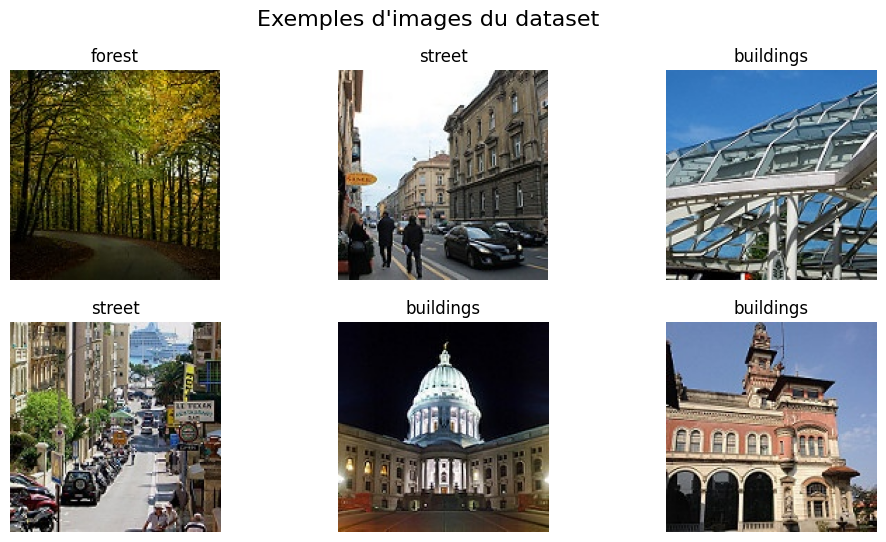

In [12]:
# Compter combien d'images par classe
unique, counts = np.unique(y, return_counts=True)

print("Nombre d'images par classe :")
for cls, count in zip(classes, counts):
    print(f"{cls} : {count} images")

import matplotlib.pyplot as plt
import random

plt.figure(figsize=(12, 6))
for i in range(6):  # afficher 6 images
    idx = random.randint(0, len(X)-1)
    plt.subplot(2, 3, i+1)
    plt.imshow(X[idx])
    plt.title(classes[y[idx]])
    plt.axis("off")

plt.suptitle("Exemples d'images du dataset", fontsize=16)
plt.show()

### 2.3. Normalisation et division du DataSet

### Pourquoi normaliser les données ?

En Deep Learning, il est important de **normaliser les images** afin de ramener leurs valeurs de pixels dans une même échelle.  
Les pixels sont initialement codés entre **0 et 255**, or les réseaux de neurones fonctionnent mieux lorsque les entrées sont comprises entre **0 et 1**.  

Concrètement, on divise chaque pixel par `255.0`, ce qui ramène toutes les valeurs dans l’intervalle `[0,1]`.  


In [5]:
from sklearn.model_selection import train_test_split

# Normalisation des données [0, 1]

X_normalized = X / 255.0

On divise le dataset en **80% pour l’entraînement** et **20% pour la validation** afin d’évaluer la performance du modèle sur des données jamais vues.  

In [6]:
# Division des données (80% entraînement, 20% validation)

X_train, X_val, y_train, y_val = train_test_split(X_normalized, y, test_size=0.2, random_state=42)

In [15]:
# Tailles des ensembles
print("Taille de X_train :", X_train.shape)
print("Taille de X_val   :", X_val.shape)

# Distribution des classes dans train et validation
unique_train, counts_train = np.unique(y_train, return_counts=True)
unique_val, counts_val = np.unique(y_val, return_counts=True)

print("\nRépartition des classes dans l'ensemble d'entraînement :")
for cls, count in zip(unique_train, counts_train):
    print(f"{classes[cls]} : {count} images")

print("\nRépartition des classes dans l'ensemble de validation :")
for cls, count in zip(unique_val, counts_val):
    print(f"{classes[cls]} : {count} images")

Taille de X_train : (11227, 150, 150, 3)
Taille de X_val   : (2807, 150, 150, 3)

Répartition des classes dans l'ensemble d'entraînement :
mountain : 1997 images
street : 1896 images
buildings : 1766 images
sea : 1813 images
forest : 1785 images
glacier : 1970 images

Répartition des classes dans l'ensemble de validation :
mountain : 515 images
street : 486 images
buildings : 425 images
sea : 461 images
forest : 486 images
glacier : 434 images


### 2.4. Data Augmentation

La **data augmentation** consiste à créer de nouvelles images artificielles à partir des images du dataset d’entraînement,  
en appliquant différentes transformations (rotations, décalages, zoom, retournements horizontaux, etc.).  

L’objectif est de **diversifier les données** sans avoir besoin de collecter plus d’images,  
ce qui rend le modèle **plus robuste** et limite le risque de **surapprentissage (overfitting)**.  

Comme il s’agit d’un problème de **classification multi-classes** (6 classes différentes),  
les labels numériques (`0, 1, 2, 3, 4, 5`) sont transformés en **vecteurs binaires** (*one-hot encoding*).  

Exemple : une image de classe `3` devient `[0, 0, 0, 1, 0, 0]`.  
Cela permet au modèle d’apprendre correctement à distinguer chaque classe et de calculer la perte via la fonction `categorical_crossentropy` plus tard.  

In [7]:
from tensorflow.keras.utils import to_categorical

y_train = to_categorical(y_train)
y_val = to_categorical(y_val)

In [8]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Générateur avec augmentation de données pour l'entraînement
train_datagen = ImageDataGenerator(
    rotation_range=20,       # rotations jusqu'à 20°
    width_shift_range=0.2,   # décalage horizontal 
    height_shift_range=0.2,  # décalage vertical
    zoom_range=0.2,          # zoom
    horizontal_flip=True     # retournement horizontal
)

# Générateur pour la validation (pas d'augmentation, juste normalisation)
val_datagen = ImageDataGenerator()

# Création des itérateurs
it_train = train_datagen.flow(X_train, y_train, batch_size=32, shuffle=True)
it_val   = val_datagen.flow(X_val, y_val, batch_size=32, shuffle=False)

**générateurs (`ImageDataGenerator`)** :  
- `it_train` : fournit les images augmentées (normalisées précédement) pour l’entraînement.  
- `it_val` : fournit les images normalisées précédement (sans augmentation) pour la validation.  

Ces générateurs évitent de charger toutes les images en mémoire et facilitent l’entraînement. 

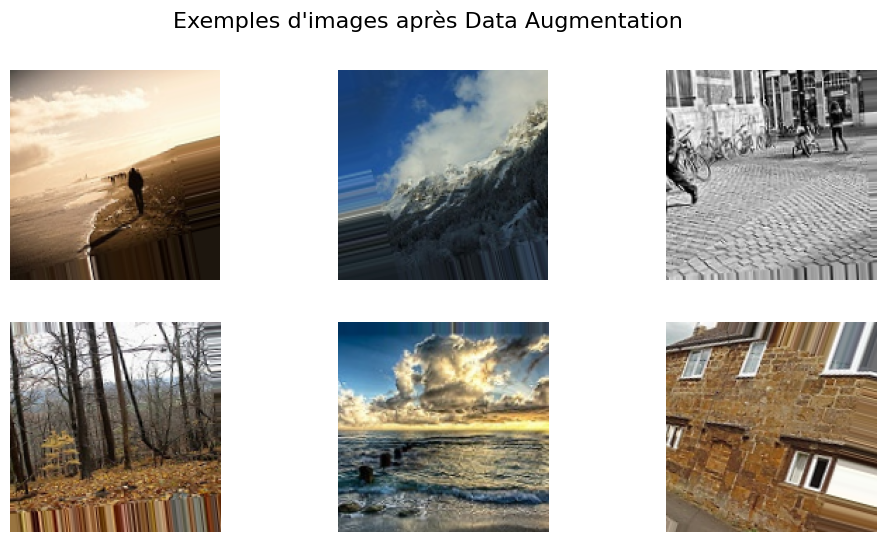

In [19]:
import matplotlib.pyplot as plt

# Récupérer un batch d’images augmentées
images_batch, labels_batch = next(it_train)

# Afficher 6 exemples
plt.figure(figsize=(12,6))
for i in range(6):
    plt.subplot(2,3,i+1)
    plt.imshow(images_batch[i])
    plt.axis("off")
plt.suptitle("Exemples d'images après Data Augmentation", fontsize=16)
plt.show()

## 3. Conception et Implémentation du Modèle CNN

### Conception du Modèle CNN

Nous avons construit un **réseau de neurones convolutif (CNN)** adapté à la classification d’images :  

- **Couches Convolution + ReLU + MaxPooling**  
  Chaque bloc applique des filtres (convolution) pour détecter des motifs visuels (bords, textures, formes),  
  suivis de la fonction d’activation **ReLU** (*Rectified Linear Unit*) qui introduit de la non-linéarité et accélère l’apprentissage.  
  Le **MaxPooling** réduit la taille des matrices tout en conservant l’information essentielle.

  
  Réduire la taille est important car :  
  - cela diminue le **nombre de paramètres**, donc le temps de calcul,  
  - cela rend le modèle plus robuste en se concentrant sur les **caractéristiques les plus importantes** (ex : présence d’un bord, texture),  
  - et cela limite le risque de **surapprentissage**.

- **GlobalAveragePooling2D vs Flatten**  
  Plutôt que d’aplatir toutes les matrices (ce qui génère beaucoup de paramètres),  
  nous utilisons **GlobalAveragePooling2D** qui calcule la moyenne de chaque matrice.  
      Cela réduit fortement le nombre de paramètres, limite le risque de **surapprentissage** et améliore la généralisation.

- **Couches Fully Connected (Dense)**  
  - Une couche Dense de 128 neurones (avec **ReLU**) pour combiner les informations extraites.  
  - Une couche **Dropout (0.5)** qui désactive aléatoirement 50% des neurones afin d’éviter le surapprentissage.  
  - Une dernière couche Dense de 6 neurones avec **Softmax** → produit une probabilité pour chacune des 6 classes,  
    et le modèle choisit la classe avec la probabilité la plus élevée.


In [21]:
from tensorflow.keras import layers, models

model = models.Sequential()

# Couches convolution + pooling
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Passage en fully connected
model.add(layers.GlobalAveragePooling2D())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dropout(0.5))   # régularisation
model.add(layers.Dense(6, activation='softmax'))  # 6 classes

model.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-09-21 08:23:08.134019: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 148, 148, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 74, 74, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 72, 72, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 36, 36, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 34, 34, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 17, 17, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 128)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 6)              │           774 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 110,534 (431.77 KB)

 Trainable params: 110,534 (431.77 KB)

 Non-trainable params: 0 (0.00 B)

### 4. Entraînement du Modèle

Nous compilons le modèle avec l’optimiseur **Adam** et la fonction de perte **categorical_crossentropy**, adaptée à la classification multi-classes.  
L’entraînement est lancé sur **20 epochs** avec la data augmentation, en suivant la performance sur le jeu de validation.  

In [ ]:
# Compilation du modèle
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Entraînement avec data augmentation
history = model.fit(
    it_train,
    epochs=20,
    validation_data=it_val,
    verbose=1
)

In [ ]:
# Sauvegarde du modèle (car Problème de RAM sinon)
model.save("/kaggle/working/model_1.h5")

In [61]:
from tensorflow.keras.models import load_model

# Charger le modèle sauvegardé au format H5
model = load_model("/kaggle/input/model_2/keras/default/1/model_1.h5")

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
import json

# Sauvegarde
with open("/kaggle/working/history_bs32.json", "w") as f:
    json.dump(history.history, f)

In [23]:
# Importation des résulats
import json

with open("/kaggle/input/history-bs32/history_bs32.json", "r") as f:
    history_bs32 = json.load(f)

# Conversion en DataFrame
df_history = pd.DataFrame(history_bs32)

# Affichage
print(df_history.head(20)) 

    accuracy      loss  val_accuracy  val_loss
0   0.408836  1.359153      0.516209  1.111375
1   0.505389  1.176777      0.542928  1.089790
2   0.552864  1.099331      0.604204  0.937169
3   0.594193  1.013483      0.592804  0.996385
4   0.627772  0.953563      0.674385  0.806168
5   0.654048  0.895749      0.691486  0.770625
6   0.676316  0.845314      0.708586  0.768636
7   0.708025  0.788637      0.763805  0.625721
8   0.721386  0.761399      0.771286  0.599190
9   0.731184  0.734576      0.791949  0.551692
10  0.748464  0.701416      0.780192  0.584292
11  0.750067  0.694102      0.788030  0.566245
12  0.758083  0.673110      0.799430  0.540962
13  0.759776  0.669032      0.799074  0.525161
14  0.766011  0.651055      0.805843  0.525814
15  0.765654  0.639428      0.817243  0.482533
16  0.773582  0.629030      0.819736  0.486791
17  0.783379  0.610624      0.809761  0.521204
18  0.783557  0.607579      0.804418  0.521190
19  0.783825  0.596873      0.822943  0.470551


In [26]:
print("Max val_acc",np.max(df_history['val_accuracy']))

Max val_acc 0.8229426145553589


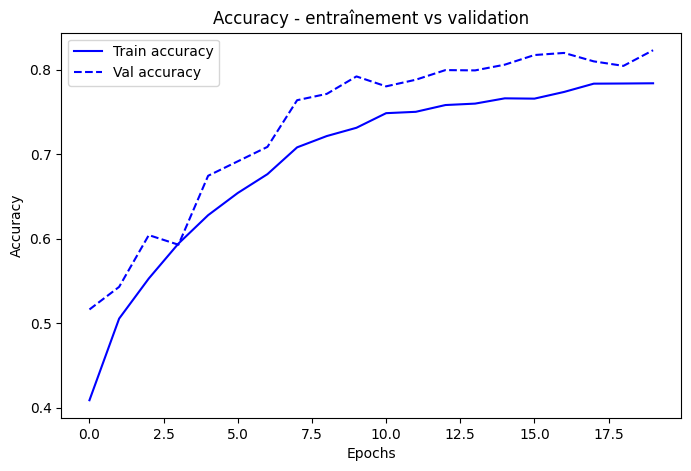

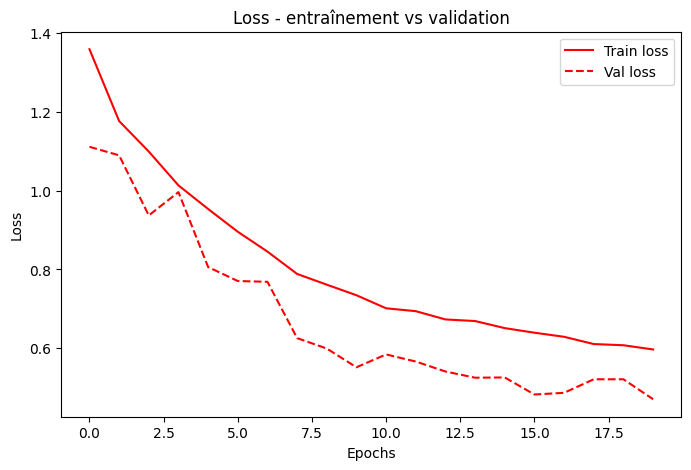

In [25]:
# Accuracy
plt.figure(figsize=(8,5))
plt.plot(df_history['accuracy'], 'b-', label='Train accuracy')   # bleu plein
plt.plot(df_history['val_accuracy'], 'b--', label='Val accuracy') # bleu pointillé
plt.title("Accuracy - entraînement vs validation")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()
plt.show()

# Loss
plt.figure(figsize=(8,5))
plt.plot(df_history['loss'], 'r-', label='Train loss')   # rouge plein
plt.plot(df_history['val_loss'], 'r--', label='Val loss') # rouge pointillé
plt.title("Loss - entraînement vs validation")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()

### Interprétation des courbes d’entraînement

- **Accuracy** : on observe que la précision sur le jeu d’entraînement et sur le jeu de validation augmente régulièrement jusqu’à atteindre environ **80%**.  
  Les deux courbes restent proches, ce qui est un bon signe : le modèle **généralise bien** et ne mémorise pas seulement les données d’entraînement.

- **Loss** : elle diminue de manière stable à la fois pour l’entraînement et la validation.  
  La courbe de validation suit bien celle de l’entraînement, sans écart significatif.

Conclusion :  
Il n’y a pas de signe clair de **surapprentissage (overfitting)**.  
Les performances en validation sont très proches de celles en entraînement, ce qui montre que le modèle est capable de bien se généraliser sur des données qu’il n’a jamais vues.  


### 5. Évaluation du Modèle

L’évaluation du modèle est réalisée sur le jeu de test afin de mesurer ses performances sur des données **totalement nouvelles**.  
Cela permet de vérifier la capacité de généralisation du modèle et d’identifier ses points forts et ses limites.  
Nous utilisons des métriques comme la **précision**, le **rappel**, le **score F1**, ainsi qu’une **matrice de confusion** pour analyser les erreurs de classification.  

94/94 ━━━━━━━━━━━━━━━━━━━━ 19s 202ms/step


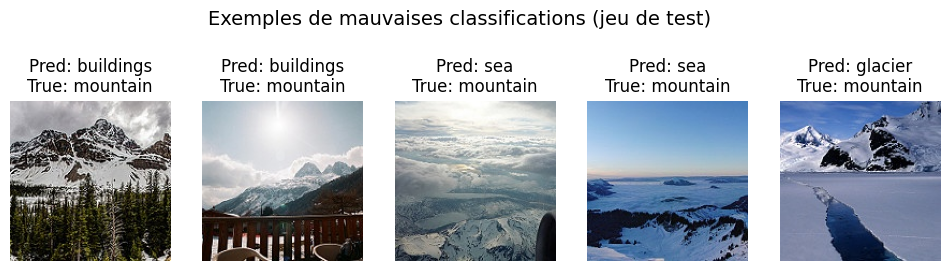

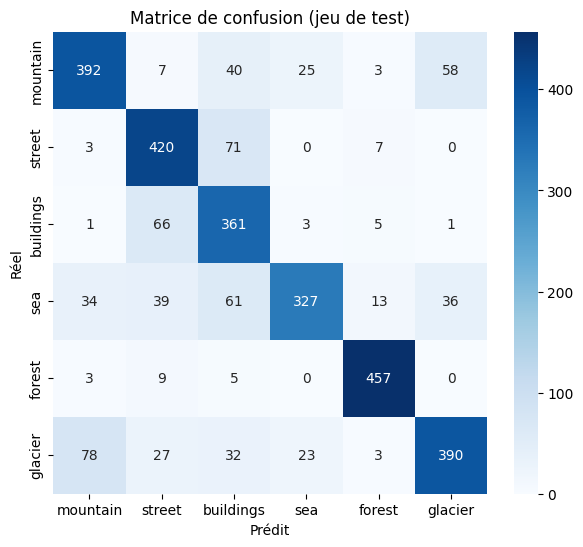

Rapport de classification (jeu de test) :

              precision    recall  f1-score   support

    mountain       0.77      0.75      0.76       525
      street       0.74      0.84      0.79       501
   buildings       0.63      0.83      0.72       437
         sea       0.87      0.64      0.74       510
      forest       0.94      0.96      0.95       474
     glacier       0.80      0.71      0.75       553

    accuracy                           0.78      3000
   macro avg       0.79      0.79      0.78      3000
weighted avg       0.79      0.78      0.78      3000



In [62]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

# 1. Charger et préparer les données du jeu de test
test_dir = "/kaggle/input/intel-image-classification/seg_test/seg_test"
img_size = (150, 150)

X_test = []
y_test = []
classes = os.listdir(test_dir)

for idx, c in enumerate(classes):
    folder = os.path.join(test_dir, c)
    for file in os.listdir(folder):
        img_path = os.path.join(folder, file)
        img = Image.open(img_path).resize(img_size)
        img = np.array(img)
        X_test.append(img)
        y_test.append(idx)

X_test = np.array(X_test) / 255.0   # normalisation
y_test = np.array(y_test)

# 2. Prédictions
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = y_test  # pas besoin de one-hot ici

# 3. Quelques erreurs de classification
misclassified_idx = np.where(y_pred_classes != y_true)[0]

plt.figure(figsize=(12,6))
for i, idx in enumerate(misclassified_idx[:5]):  # afficher 5 erreurs
    plt.subplot(1,5,i+1)
    plt.imshow(X_test[idx])
    plt.title(f"Pred: {classes[y_pred_classes[idx]]}\nTrue: {classes[y_true[idx]]}")
    plt.axis("off")
plt.suptitle("Exemples de mauvaises classifications (jeu de test)", fontsize=14, y=0.78)
plt.show()

# 4. Matrice de confusion
cm = confusion_matrix(y_true, y_pred_classes)

plt.figure(figsize=(7,6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=classes,
            yticklabels=classes)
plt.xlabel("Prédit")
plt.ylabel("Réel")
plt.title("Matrice de confusion (jeu de test)")
plt.show()

# 5. Rapport de classification
print("Rapport de classification (jeu de test) :\n")
print(classification_report(y_true, y_pred_classes, target_names=classes))

### Conclusion  

Le modèle atteint une **accuracy globale de 78%** sur le jeu de test.  
Certaines catégories sont bien reconnues, comme **forêt** (F1 = 0.96), mais d’autres posent plus de difficultés, notamment **buildings** (F1 = 0.64) et **street** (F1 = 0.78), qui sont souvent confondues entre elles. De même, les classes **montagne** et **glacier** présentent des confusions fréquentes, probablement en raison de leur ressemblance visuelle.  

Ces résultats montrent que le modèle est globalement performant, mais qu’il reste une marge d’amélioration.  
Dans la **partie 6 (Améliorations et Expérimentations)**, nous allons tester différentes stratégies (réglage des hyperparamètres, transfer learning, etc.) afin d’améliorer la capacité de généralisation du modèle et de réduire ces erreurs de classification.  


## 6. Améliorations et Expérimentations

### 6.1 Cross-validation sur le nombre d’époques optimal et la taille des batchs

L’objectif de cette expérimentation est de déterminer les **meilleurs hyperparamètres de base** pour notre modèle :  
- le **nombre d’époques optimal**,  
- la **taille des batchs**.  

En pratique :  
- Si l’on choisit **trop peu d’époques**, le modèle n’a pas le temps d’apprendre correctement (**underfitting**).  
- Si l’on choisit **trop d’époques**, le modèle finit par mémoriser les données d’entraînement et perd en capacité de généralisation (**overfitting**).  
- De la même manière, la **taille des batchs** influence la stabilité et la vitesse de convergence :  
  - **petits batchs** → plus de bruit, mais souvent meilleure généralisation,  
  - **grands batchs** → entraînement plus stable et rapide, mais parfois moins bonne performance finale.  

Pour éviter de fixer ces paramètres au hasard, nous utilisons :  
- **EarlyStopping** pour identifier automatiquement le nombre d’époques nécessaire,  
- une **cross-validation sur différents batch sizes (32, 64, 128)** pour comparer leur impact.  

Cette étape permet donc de construire un modèle plus robuste, entraîné **juste le bon nombre d’époques** avec **la taille de batch la plus adaptée**, afin d’optimiser à la fois la performance et le temps de calcul.

In [ ]:
# Compilation
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# EarlyStopping
early_stop = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Entraînement
history_bs32 = model.fit(
    train_datagen.flow(X_train, y_train, batch_size=32, shuffle=True),
    epochs=30,
    validation_data=val_datagen.flow(X_val, y_val, batch_size=32, shuffle=False),
    callbacks=[early_stop],
    verbose=1
)

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
with open("/kaggle/working/history_bs32_early.json", "w") as f:
    json.dump(history_bs32_early.history, f)

In [36]:
# Importation des résulats
with open("/kaggle/input/history-bs32-early/history_bs32_early.json", "r") as f:
    history_bs32_early = json.load(f)

# Conversion en DataFrame
df_history_1 = pd.DataFrame(history_bs32_early)

# Affichage
print(df_history_1.head(30)) 

    accuracy      loss  val_accuracy  val_loss
0   0.410261  1.372821      0.541503  1.120026
1   0.523916  1.153469      0.566797  1.009511
2   0.566402  1.064301      0.643392  0.880567
3   0.609869  0.980840      0.696117  0.795508
4   0.651287  0.906955      0.724973  0.740711
5   0.667053  0.867630      0.695761  0.804066
6   0.700276  0.806212      0.754898  0.667770
7   0.718892  0.776160      0.778055  0.591941
8   0.729759  0.741594      0.769861  0.606082
9   0.744633  0.697598      0.718204  0.720109
10  0.747662  0.695698      0.792305  0.557409
11  0.761379  0.679264      0.783755  0.574051
12  0.766011  0.662759      0.822586  0.491417
13  0.769039  0.639807      0.813324  0.509681
14  0.772780  0.631933      0.793374  0.536752
15  0.779015  0.625314      0.801567  0.528483


In [37]:
print("Max val_acc",np.max(df_history_1['val_accuracy']))

Max val_acc 0.8225864171981812


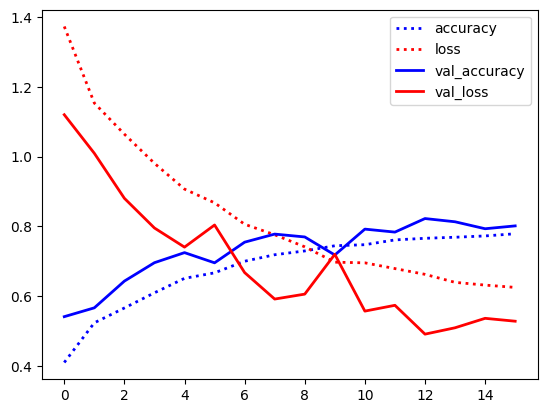

In [64]:
df_history_1.plot(lw=2,style=['b:','r:','b-','r-']);

In [ ]:
# Compilation
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# EarlyStopping
early_stop = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Entraînement
history_bs64 = model.fit(
    train_datagen.flow(X_train, y_train, batch_size=64, shuffle=True),
    epochs=30,
    validation_data=val_datagen.flow(X_val, y_val, batch_size=64, shuffle=False),
    callbacks=[early_stop],
    verbose=1
)

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
with open("/kaggle/working/history_bs64_early.json", "w") as f:
    json.dump(history_bs64_early.history, f)

In [38]:
# Importation des résulats
with open("/kaggle/input/history-bs64-early/history_bs64_early.json", "r") as f:
    history_bs64_early = json.load(f)

# Conversion en DataFrame
df_history_2 = pd.DataFrame(history_bs64_early)

# Affichage
print(df_history_2.head(30)) 

    accuracy      loss  val_accuracy  val_loss
0   0.369823  1.461786      0.508728  1.223657
1   0.498174  1.196103      0.494478  1.263569
2   0.544669  1.110532      0.604560  0.973879
3   0.575488  1.059813      0.566085  1.056836
4   0.600160  0.996573      0.627360  0.934428
5   0.630088  0.955576      0.629498  0.917843
6   0.645052  0.922957      0.654792  0.859579
7   0.662599  0.874196      0.701104  0.751105
8   0.685936  0.844763      0.737798  0.697754
9   0.699564  0.812068      0.737442  0.686537
10  0.707936  0.784094      0.743855  0.698610
11  0.729670  0.745351      0.772355  0.605922
12  0.730026  0.735906      0.754898  0.650607
13  0.737062  0.720035      0.773780  0.605501
14  0.744277  0.697662      0.784824  0.577060
15  0.757371  0.673042      0.770930  0.584736
16  0.752828  0.677609      0.797292  0.539848
17  0.764051  0.661862      0.789455  0.544523
18  0.762359  0.662295      0.806911  0.510527
19  0.768059  0.650190      0.783755  0.584126
20  0.771355 

In [39]:
print("Max val_acc",np.max(df_history_2['val_accuracy']))

Max val_acc 0.8361240029335022


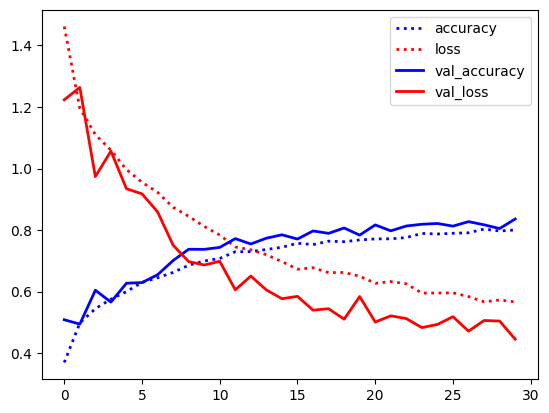

In [63]:
df_history_2.plot(lw=2,style=['b:','r:','b-','r-']);

In [ ]:
# Compilation
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# EarlyStopping
early_stop = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Entraînement
history_bs128 = model.fit(
    train_datagen.flow(X_train, y_train, batch_size=128, shuffle=True),
    epochs=30,
    validation_data=val_datagen.flow(X_val, y_val, batch_size=128, shuffle=False),
    callbacks=[early_stop],
    verbose=1
)

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
with open("/kaggle/working/history_bs64_early.json", "w") as f:
    json.dump(history_bs64_early.history, f)

In [40]:
# Importation des résulats
with open("/kaggle/input/history-bs128-early/history_bs128_early.json", "r") as f:
    history_bs128_early = json.load(f)

# Conversion en DataFrame
df_history_3 = pd.DataFrame(history_bs128_early)

# Affichage
print(df_history_3.head(30)) 

    accuracy      loss  val_accuracy  val_loss
0   0.362341  1.468528      0.415390  1.383636
1   0.473858  1.235276      0.503028  1.228251
2   0.528993  1.146455      0.589241  1.012654
3   0.541195  1.120071      0.587460  1.021785
4   0.567115  1.075421      0.599216  0.994776
5   0.588492  1.033449      0.639116  0.885195
6   0.597221  1.008715      0.628429  0.905690
7   0.618509  0.970767      0.686854  0.799507
8   0.631157  0.936710      0.682936  0.817939
9   0.645319  0.905374      0.702529  0.765714
10  0.655562  0.903353      0.703598  0.767594
11  0.669458  0.871334      0.719986  0.725740
12  0.676672  0.850524      0.730673  0.699377
13  0.687272  0.829044      0.738155  0.688566
14  0.699920  0.794057      0.753117  0.651288
15  0.709272  0.779947      0.769149  0.627894
16  0.722455  0.751690      0.741717  0.693922
17  0.711855  0.771870      0.749555  0.672200
18  0.725216  0.746638      0.760955  0.619614
19  0.727354  0.729900      0.770217  0.606915
20  0.734390 

In [41]:
print("Max val_acc",np.max(df_history_3['val_accuracy']))

Max val_acc 0.7958675026893616


In [ ]:
# Compilation
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# EarlyStopping
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Entraînement
history_bs_ok = model.fit(
    train_datagen.flow(X_train, y_train, batch_size=32, shuffle=True),
    epochs=30,
    validation_data=val_datagen.flow(X_val, y_val, batch_size=32, shuffle=False),
    callbacks=[early_stop],
    verbose=1
)

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
with open("/kaggle/working/history_bs32_early_5.json", "w") as f:
    json.dump(history_bs64_early.history, f)

In [42]:
# Importation des résulats
with open("/kaggle/input/history-bs32-early-5/history_bs32_early_5.json", "r") as f:
    history_bs32_early_5 = json.load(f)

# Conversion en DataFrame
df_history_4 = pd.DataFrame(history_bs32_early_5)

# Affichage
print(df_history_4.head(30)) 

    accuracy      loss  val_accuracy  val_loss
0   0.412042  1.370329      0.458853  1.221238
1   0.514741  1.164537      0.541147  1.079349
2   0.550459  1.106739      0.591735  0.997964
3   0.582613  1.040683      0.632704  0.907712
4   0.621003  0.961203      0.674029  0.822634
5   0.659660  0.894289      0.738155  0.680951
6   0.694397  0.828700      0.725686  0.714789
7   0.707580  0.793314      0.722480  0.691675
8   0.719694  0.756067      0.751692  0.670302
9   0.734568  0.723496      0.721054  0.715782
10  0.745257  0.692210      0.783399  0.576063
11  0.756302  0.684614      0.785536  0.593156
12  0.764764  0.660879      0.782686  0.550690
13  0.767079  0.650669      0.801567  0.525668
14  0.767614  0.650583      0.770930  0.592957
15  0.779549  0.617554      0.814036  0.501211
16  0.786497  0.606500      0.818668  0.472625
17  0.788278  0.600156      0.821874  0.472251
18  0.793890  0.585959      0.797649  0.525169
19  0.798611  0.573392      0.809761  0.504331
20  0.800748 

In [43]:
print("Max val_acc",np.max(df_history_4['val_accuracy']))

Max val_acc 0.8464552760124207


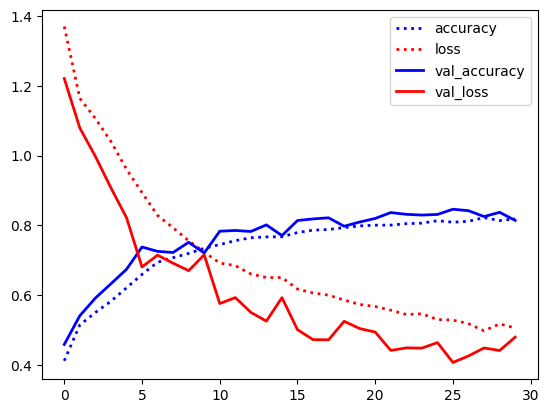

In [44]:
df_history_4.plot(lw=2,style=['b:','r:','b-','r-']);

### 6.2 Cross-validation sur la regularisation

Pour améliorer la capacité de généralisation du modèle et éviter le **surapprentissage (overfitting)**,  
nous avons testé différentes techniques de **régularisation** :

#### Dropout
- Le **Dropout** consiste à désactiver aléatoirement un certain pourcentage de neurones à chaque itération.  
- Cela empêche certains neurones de "dominer" l’apprentissage et force le réseau à apprendre des représentations plus robustes.  
- Dans notre modèle, nous avons ajouté du **Dropout après chaque bloc convolution + pooling**, avec un taux croissant (0.25 → 0.5).  
    Résultat : le modèle devient moins sensible aux données d’entraînement et généralise mieux.

#### Batch Normalization + Dropout
- Nous avons également testé une combinaison de **Batch Normalization** et de **Dropout**.  
- La **Batch Normalization** normalise les activations de chaque couche, ce qui stabilise et accélère l’apprentissage.  

    L’idée est de comparer ces deux approches (Dropout seul vs Batch Normalization + Dropout) afin de trouver le meilleur compromis entre **stabilité** et **performance**.


Nous avons également intégré dans notre code : 

#### ReduceLROnPlateau
- Le **ReduceLROnPlateau** est un callback qui **réduit automatiquement le taux d’apprentissage** si la validation loss ne s’améliore plus.  
- Cela permet d’éviter de rester bloqué dans un plateau d’optimisation et de continuer à affiner les poids du modèle.  
- Paramètres choisis : `factor=0.5` (division du learning rate par 2) et `patience=2`.

### Dropout

In [ ]:

from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Définition du modèle
model = models.Sequential()

# Bloc 1
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 2
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 3
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 4 (nouveau)
model.add(layers.Conv2D(256, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Passage en fully connected
model.add(layers.GlobalAveragePooling2D())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dropout(0.5))   # régularisation plus forte
model.add(layers.Dense(6, activation='softmax'))  # 6 classes

model.summary()

# Compilation
model.compile(optimizer=Adam(learning_rate=0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Callbacks : EarlyStopping + ReduceLROnPlateau
early_stop = EarlyStopping(monitor='val_loss',
                           patience=5,
                           restore_best_weights=True)

reduce_lr = ReduceLROnPlateau(monitor='val_loss',
                              factor=0.5,
                              patience=2,
                              min_lr=1e-6)

# Entraînement
history_dropout4 = model.fit(
    train_datagen.flow(X_train, y_train, batch_size=32, shuffle=True),
    epochs=30,  # on peut mettre un peu plus car EarlyStopping arrêtera avant
    validation_data=val_datagen.flow(X_val, y_val, batch_size=32, shuffle=False),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
with open("/kaggle/working/(history_dropout4.json", "w") as f:
    json.dump(history_dropout4.history, f)

In [47]:
# Importation des résulats
with open("/kaggle/input/history-dropout4/history_dropout4.json", "r") as f:
    history_dropout4 = json.load(f)

# Conversion en DataFrame
df_history_5 = pd.DataFrame(history_dropout4)

# Affichage
print(df_history_5.head(30)) 

    accuracy      loss  val_accuracy  val_loss  learning_rate
0   0.400374  1.363328      0.425365  1.190349       0.001000
1   0.528904  1.119867      0.643392  0.905689       0.001000
2   0.628841  0.952706      0.679373  0.834149       0.001000
3   0.672931  0.872959      0.750623  0.685325       0.001000
4   0.703037  0.810225      0.759886  0.661581       0.001000
5   0.721208  0.751118      0.753473  0.644709       0.001000
6   0.738488  0.731944      0.766299  0.628102       0.001000
7   0.749265  0.700228      0.790167  0.579196       0.001000
8   0.758707  0.680767      0.816530  0.502782       0.001000
9   0.776254  0.633201      0.809405  0.522719       0.001000
10  0.775808  0.624131      0.801924  0.513840       0.001000
11  0.798967  0.570500      0.841468  0.438775       0.000500
12  0.803866  0.556767      0.823655  0.459113       0.000500
13  0.805024  0.551247      0.828999  0.457202       0.000500
14  0.819898  0.507798      0.843962  0.431525       0.000250
15  0.81

Max val_acc 0.852155327796936


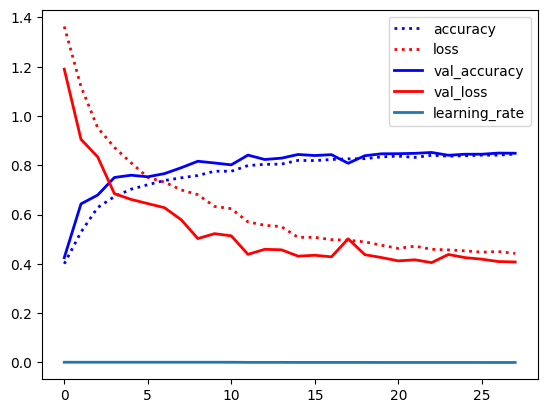

In [48]:
df_history_5.plot(lw=2,style=['b:','r:','b-','r-']);
print("Max val_acc",np.max(df_history_5['val_accuracy']))

#### Batch Normalization + Dropout

In [ ]:
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

model = models.Sequential()

# Bloc 1
model.add(layers.Conv2D(32, (3, 3), padding="same", input_shape=(150, 150, 3)))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 2
model.add(layers.Conv2D(64, (3, 3), padding="same"))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 3
model.add(layers.Conv2D(128, (3, 3), padding="same"))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 4
model.add(layers.Conv2D(256, (3, 3), padding="same"))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Passage en fully connected
model.add(layers.GlobalAveragePooling2D())
model.add(layers.Dense(128))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(6, activation='softmax'))

model.summary()

# Compilation
model.compile(optimizer=Adam(learning_rate=0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss',
                           patience=8,
                           restore_best_weights=True)

reduce_lr = ReduceLROnPlateau(monitor='val_loss',
                              factor=0.5,
                              patience=2,
                              min_lr=1e-6)

# Entraînement
history_bn = model.fit(
    train_datagen.flow(X_train, y_train, batch_size=32, shuffle=True),
    epochs=30,
    validation_data=val_datagen.flow(X_val, y_val, batch_size=32, shuffle=False),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
with open("/kaggle/working/history_bn.json", "w") as f:
    json.dump(history_bn.history, f)

In [50]:
# Importation des résulats
with open("/kaggle/input/history-nb/history_nb.json", "r") as f:
    history_bn = json.load(f)

# Conversion en DataFrame
df_history_6 = pd.DataFrame(history_bn)

# Affichage
print(df_history_6.head(30)) 

    accuracy      loss  val_accuracy  val_loss  learning_rate
0   0.535228  1.209265      0.327396  2.173106       0.001000
1   0.656542  0.921904      0.533666  1.089587       0.001000
2   0.689855  0.838331      0.698254  0.860982       0.001000
3   0.715596  0.764908      0.648379  0.923622       0.001000
4   0.739467  0.714454      0.440328  1.856402       0.001000
5   0.767703  0.648683      0.804774  0.539746       0.000500
6   0.777144  0.614140      0.742430  0.652455       0.000500
7   0.779995  0.623266      0.704311  0.795638       0.000500
8   0.804133  0.557960      0.813324  0.513868       0.000250
9   0.802530  0.553153      0.748842  0.644143       0.000250
10  0.807429  0.544138      0.670823  0.874422       0.000250
11  0.825243  0.504783      0.819736  0.500718       0.000125
12  0.821769  0.498240      0.796936  0.577395       0.000125
13  0.823729  0.497408      0.748842  0.713225       0.000125
14  0.827826  0.487061      0.813324  0.542121       0.000063
15  0.82

Max val_acc 0.83790522813797


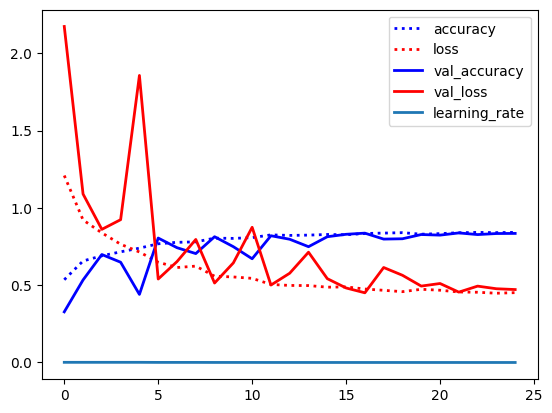

In [51]:
df_history_6.plot(lw=2,style=['b:','r:','b-','r-']);
print("Max val_acc",np.max(df_history_6['val_accuracy']))

On teste avec une autre taille de batch_size.

In [ ]:
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

model = models.Sequential()

# Bloc 1
model.add(layers.Conv2D(32, (3, 3), padding="same", input_shape=(150, 150, 3)))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 2
model.add(layers.Conv2D(64, (3, 3), padding="same"))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 3
model.add(layers.Conv2D(128, (3, 3), padding="same"))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Bloc 4
model.add(layers.Conv2D(256, (3, 3), padding="same"))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.25))

# Passage en fully connected
model.add(layers.GlobalAveragePooling2D())
model.add(layers.Dense(128))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(6, activation='softmax'))

model.summary()

# Compilation
model.compile(optimizer=Adam(learning_rate=0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss',
                           patience=8,
                           restore_best_weights=True)

reduce_lr = ReduceLROnPlateau(monitor='val_loss',
                              factor=0.5,
                              patience=2,
                              min_lr=1e-6)

# Entraînement
history_bn2 = model.fit(
    train_datagen.flow(X_train, y_train, batch_size=64, shuffle=True),
    epochs=30,
    validation_data=val_datagen.flow(X_val, y_val, batch_size=64, shuffle=False),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
with open("/kaggle/working/history_bn2.json", "w") as f:
    json.dump(history_bn2.history, f)

In [52]:
# Importation des résulats
with open("/kaggle/input/history-nb2/history_nb2.json", "r") as f:
    history_bn2 = json.load(f)

# Conversion en DataFrame
df_history_7 = pd.DataFrame(history_bn2)

# Affichage
print(df_history_7.head(30)) 

    accuracy      loss  val_accuracy  val_loss  learning_rate
0   0.537900  1.193939      0.180976  2.246503       0.001000
1   0.642113  0.923447      0.365871  1.847974       0.001000
2   0.703394  0.806100      0.674029  0.878859       0.001000
3   0.718625  0.748738      0.769505  0.643479       0.001000
4   0.743387  0.695501      0.522622  1.831722       0.001000
5   0.753986  0.666885      0.588885  1.297814       0.001000
6   0.777857  0.614597      0.757036  0.696397       0.000500
7   0.788189  0.584457      0.747773  0.700942       0.000500
8   0.808854  0.544542      0.812968  0.531785       0.000250
9   0.811971  0.530525      0.794799  0.621427       0.000250
10  0.807161  0.536417      0.717136  0.890875       0.000250
11  0.816870  0.505721      0.809405  0.548901       0.000125
12  0.819809  0.509672      0.690061  1.005910       0.000125
13  0.826668  0.487806      0.760598  0.690220       0.000063
14  0.829785  0.480100      0.788742  0.634143       0.000063
15  0.82

Max val_acc 0.8129675984382629


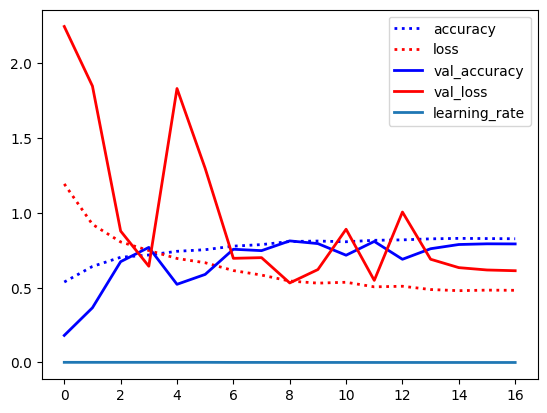

In [53]:
df_history_7.plot(lw=2,style=['b:','r:','b-','r-']);
print("Max val_acc",np.max(df_history_7['val_accuracy']))

### Conlusion

- **Dropout seul** : la courbe est stable, la loss diminue correctement et la `val_accuracy` atteint un maximum de **0.85**.  
- **Dropout + Batch Normalization** : les courbes sont beaucoup plus instables, la loss de validation fluctue fortement et la `val_accuracy` plafonne autour de **0.81**.  

    Dans notre cas, l’ajout de **Batch Normalization** n’apporte pas d’amélioration, au contraire il déstabilise l’entraînement.  
Nous retenons donc la configuration **Dropout seul**, qui donne les meilleurs résultats.  

### 6.3. Transfer learning

### Transfer Learning avec ResNet50  

Le **transfer learning** consiste à réutiliser un modèle déjà pré-entraîné sur une grande base de données (ici **ImageNet**)  
et à l’adapter à notre problème spécifique (classification de 6 scènes naturelles).  

- Nous utilisons **ResNet50**, qui a déjà appris à détecter des formes, textures et motifs généraux utiles pour les images.  
- Nous gardons la majorité des couches gelées (poids inchangés) et nous **ne réentraînons que les 30 dernières couches**,  
  afin d’affiner le modèle sur notre dataset tout en profitant du savoir acquis sur ImageNet.  
- Ensuite, nous ajoutons une "tête de classification" adaptée à notre tâche : GlobalAveragePooling, Dense(128, ReLU), Dropout(0.5), et une couche finale **Softmax (6 classes)**.  

    Cette approche permet d’obtenir de bonnes performances même avec un dataset de taille modeste,  
car le modèle profite déjà d’une **excellente base de connaissances visuelles**.  


In [ ]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Charger ResNet50 pré-entraîné
base_model = ResNet50(weights="imagenet", 
                      include_top=False, 
                      input_shape=(150, 150, 3))

# Défiger uniquement les 30 dernières couches
for layer in base_model.layers[-30:]:
    layer.trainable = True

# Ajouter notre tête de classification
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(6, activation='softmax')  # 6 classes
])

model.summary()

# Recompiler avec un LR très petit (sinon ça détruit les poids pré-entraînés)
model.compile(optimizer=Adam(learning_rate=1e-5),
              loss='categorical_crossentropy',
              metrics=['accuracy'])
# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

# Relancer l’entraînement (fine-tuning)
history_ft = model.fit(
    train_datagen.flow(X_train, y_train, batch_size=64, shuffle=True),
    epochs=20,
    validation_data=val_datagen.flow(X_val, y_val, batch_size=64, shuffle=False),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

In [ ]:
# Sauvegarde des résulats de l'entrainement (car Problème de RAM sinon)
with open("/kaggle/working/history_ft.json", "w") as f:
    json.dump(history_ft.history, f)

In [54]:
# Importation des résulats
with open("/kaggle/input/history-ft/history_ft.json", "r") as f:
    history_ft = json.load(f)

# Conversion en DataFrame
df_history_8 = pd.DataFrame(history_ft)

# Affichage
print(df_history_8.head(30)) 

    accuracy      loss  val_accuracy  val_loss  learning_rate
0   0.481429  1.430268      0.107232  3.363237       0.000010
1   0.759063  0.686610      0.169576  2.826732       0.000010
2   0.835219  0.496847      0.341290  1.688049       0.000010
3   0.861227  0.418195      0.729961  0.717196       0.000010
4   0.880110  0.360987      0.847524  0.415550       0.000010
5   0.894006  0.312241      0.905237  0.274706       0.000010
6   0.901398  0.291833      0.919131  0.232034       0.000010
7   0.908702  0.270071      0.923406  0.226621       0.000010
8   0.915917  0.250941      0.926256  0.221312       0.000010
9   0.921618  0.235123      0.925187  0.212690       0.000010
10  0.922864  0.222451      0.927681  0.213101       0.000010
11  0.929367  0.204994      0.925543  0.217248       0.000010
12  0.931772  0.202140      0.928393  0.210019       0.000010
13  0.938986  0.178143      0.928037  0.212375       0.000010
14  0.941837  0.160830      0.933737  0.227472       0.000010
15  0.94

Max val_acc 0.9337370991706848


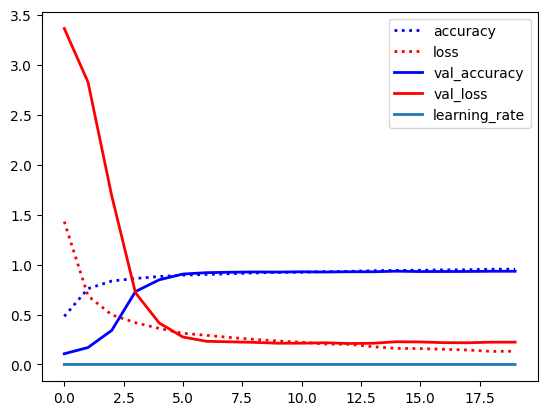

In [66]:
df_history_8.plot(lw=2,style=['b:','r:','b-','r-']);
print("Max val_acc",np.max(df_history_8['val_accuracy']))

In [ ]:
# Sauvegarde du modèle (car Problème de RAM sinon)
model.save("/kaggle/working/model_ft.h5")

### Conclusion : Choix du modèle final avec Transfer Learning  

Grâce au **Transfer Learning avec ResNet50**, nous avons obtenu notre **meilleure performance**,  
avec une `val_accuracy` maximale de **0.93**, bien supérieure aux modèles entraînés from scratch.  

Les courbes d’entraînement montrent une **évolution régulière et stable** :  
- la `val_loss` diminue de façon continue sans fluctuations importantes,  
- la `val_accuracy` progresse jusqu’à converger proprement.  

    Ce modèle est retenu comme **modèle final** car il combine :  
- une **accuracy élevée**,  
- une **stabilité d’apprentissage**,  
- et une **meilleure généralisation** par rapport aux approches précédentes.  

## 7. Interprétation et visualisation des résultats

In [15]:
# Importation du modèle
from tensorflow.keras.models import load_model
model = load_model("/kaggle/input/model_ft/keras/default/1/model_ft.h5")

### 7.1. Visualisation des filtres

Visualisation des filtres de **la première couche (conv1_conv)**

Dans un réseau de neurones convolutif (CNN), la première couche de convolution est composée de plusieurs filtres (ici, conv1_conv de ResNet50 contient **64 filtres**).

Chaque filtre apprend à détecter des motifs très simples de l’image d’entrée :

- des bords horizontaux ou verticaux,
- des zones de couleurs,
- ou encore des textures basiques.

Dans cette expérience, nous envoyons une image en entrée du réseau et observons les activations de certains filtres choisis. Cela permet de visualiser ce que chaque filtre extrait comme information.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


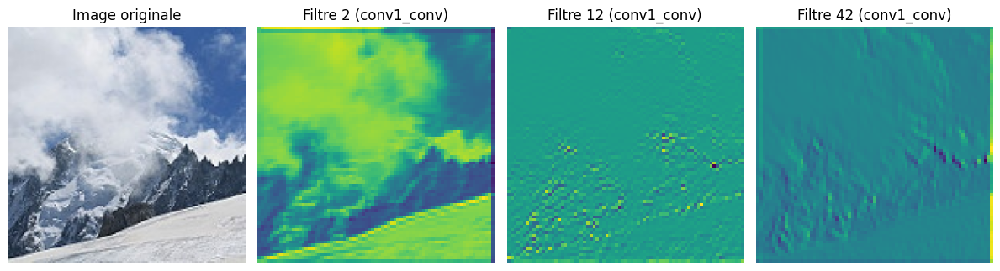

In [31]:
from tensorflow.keras import models
import matplotlib.pyplot as plt
import numpy as np

# Choix de la couche et des filtres
layer_name = "conv1_conv"
filter_indices = [2, 12, 42]   # filtres à afficher

# Récupérer la couche spécifique
base_model = model.get_layer("resnet50")
layer_output = base_model.get_layer(layer_name).output

# Nouveau modèle qui sort uniquement cette couche
activation_model = models.Model(inputs=base_model.input, outputs=layer_output)

# Image à tester
img_tensor = np.expand_dims(X_val[12], axis=0)

# Obtenir les activations
activation = activation_model.predict(img_tensor)

plt.figure(figsize=(12,4))

# Image originale
plt.subplot(1, len(filter_indices)+1, 1)
plt.imshow((X_val[12] * 255).astype("uint8"))   # ✅ éviter image noire
plt.title("Image originale")
plt.axis("off")

# Activer chaque filtre choisi
for i, f_idx in enumerate(filter_indices):
    plt.subplot(1, len(filter_indices)+1, i+2)
    plt.imshow(activation[0, :, :, f_idx], cmap="viridis")
    plt.title(f"Filtre {f_idx} ({layer_name})")
    plt.axis("off")

plt.tight_layout()
plt.show()


## Interprétation des résultats

Sur les images obtenues :  
- Le **filtre 2** conserve encore une bonne partie de la structure de l’image (on distingue bien le ciel et la montagne).  
- Le **filtre 12** met surtout en évidence certaines **textures fines** (bruits, motifs réguliers), ce qui rend l’image moins reconnaissable pour l’œil humain.  
- Le **filtre 42** extrait uniquement certains **contours et zones de contraste**, l’image devient donc encore plus abstraite.  

Pour le modèle, ces représentations sont essentielles car elles isolent des **caractéristiques discriminantes** (bords, motifs, textures) utiles pour la classification.


### 7.2. Visualisation des couches d'activation

Comme ResNet50 est un modèle très profond (50 couches), il n’est pas utile d’afficher toutes les activations.  
Nous nous concentrons sur quelques **couches clés** qui montrent l’évolution du traitement de l’image :  

- **Premières couches** → `conv1_conv` : détectent des **bords, couleurs et motifs très simples**.  
- **Milieu du réseau** → `conv3_block4_out` : détectent des **textures plus complexes** (ex : feuillage, eau, roche).  
- **Fin du réseau** → `conv4_block6_out` et `conv5_block3_out` : détectent des **motifs de haut niveau**, plus abstraits.  

  Ces 3–4 couches suffisent à comprendre comment le réseau "voit" et décompose l’image.

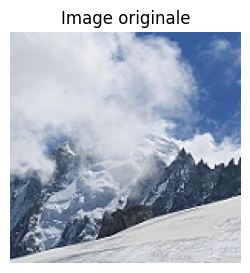

In [10]:
# L'image que nous allons visualiser dans le modèle

plt.figure(figsize=(3,3))
plt.imshow(X_val[12])
plt.title("Image originale")
plt.axis("off")
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


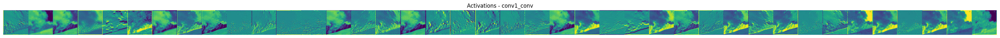

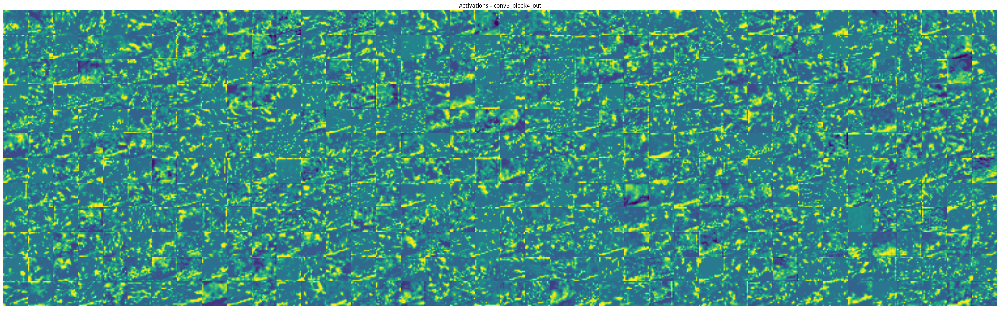

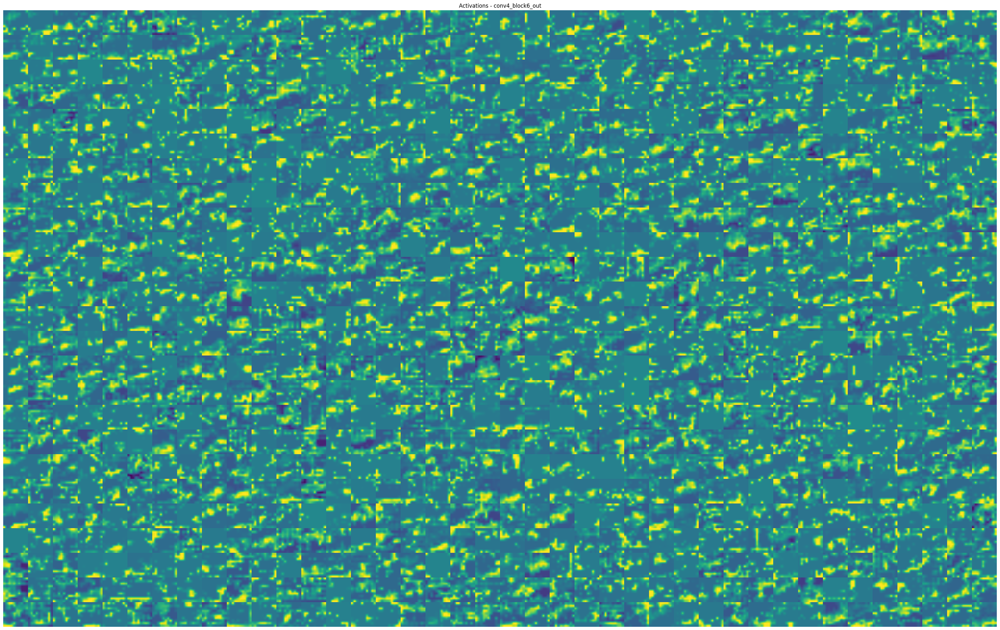

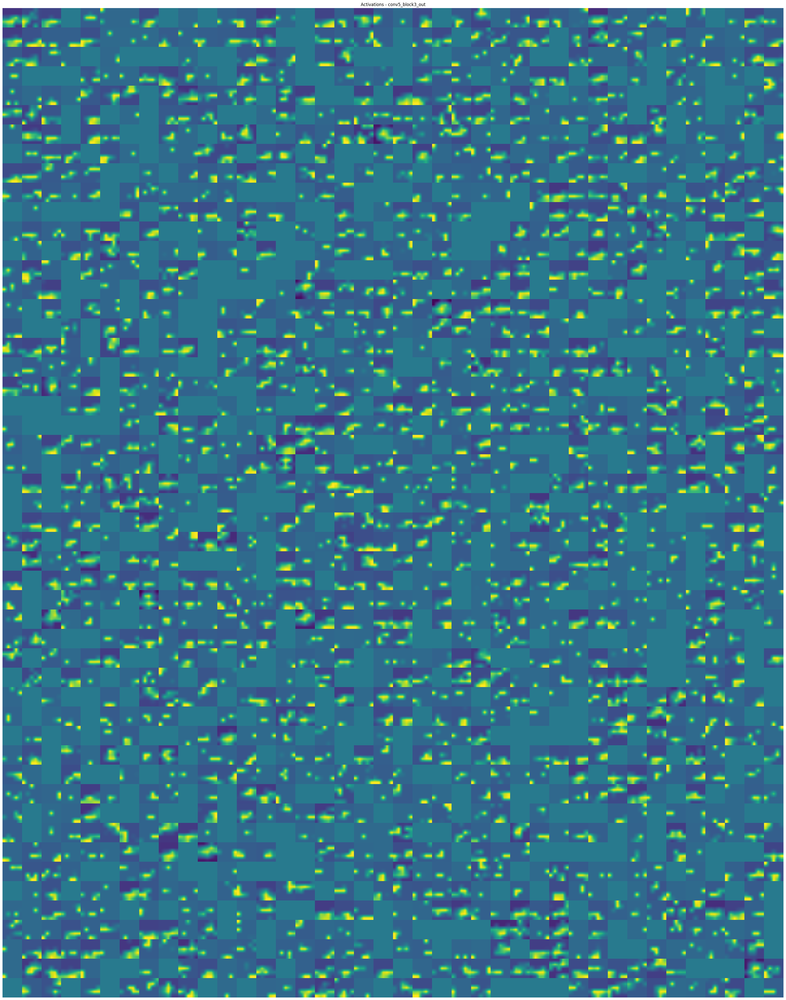

In [26]:
from tensorflow.keras import models
import cv2
import numpy as np
import matplotlib.pyplot as plt

# On sélectionne seulement certaines couches "clés"
layer_names = ["conv1_conv", "conv3_block4_out", "conv4_block6_out", "conv5_block3_out"]
layer_outputs = [model.layers[0].get_layer(name).output for name in layer_names]

# Nouveau modèle qui sort uniquement ces couches
activation_model = models.Model(inputs=model.layers[0].input, outputs=layer_outputs)

# Image de test
img_tensor = np.expand_dims(X_val[12], axis=0)
activations = activation_model.predict(img_tensor)

# Taille cible
target_size = 64  

for name, activation in zip(layer_names, activations):
    n_features = activation.shape[-1]
    images_per_row = 40
    n_cols = n_features // images_per_row

    display_grid = np.zeros((target_size * n_cols, images_per_row * target_size))

    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = activation[0, :, :, col * images_per_row + row]

            # Normalisation
            channel_image -= channel_image.mean()
            channel_image /= (channel_image.std() + 1e-5)
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')

            # Redimensionnement à target_size (fixe)
            channel_image = cv2.resize(channel_image, (target_size, target_size))

            display_grid[col * target_size:(col+1) * target_size,
                         row * target_size:(row+1) * target_size] = channel_image

    # Affichage
    plt.figure(figsize=(1. / target_size * display_grid.shape[1],
                        1. / target_size * display_grid.shape[0]))
    plt.title(f"Activations - {name}")
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    plt.axis("off")
    plt.show()


### Observations

- Chaque grande figure correspond à **une couche d’activation** (par ex. `conv1_conv` ou `conv3_block4_out`).  
- À l’intérieur, chaque petite vignette correspond à **un filtre** de cette couche.  
- Chaque filtre représente une **carte d’activation (feature map)** → il met en évidence les zones de l’image qui l’activent.  

  Exemple concret dans `conv1_conv` :  
- Nous voyons **64 filtres** (c’est la dimension de sortie de cette couche).  
- Certains filtres s’allument sur les **bords horizontaux**, d’autres sur les **bords verticaux**, d’autres encore sur des **changements de luminosité**.  
- Chaque filtre “cherche” un motif particulier dans l’image, et les zones claires montrent **où ce motif est présent**.  

Au début → des bords simples, plus tard → des textures, et en fin de réseau → des motifs très abstraits liés aux classes.  


In [96]:
# Récupérer le backbone ResNet50
base_model = model.get_layer("resnet50")

# Afficher uniquement la première couche conv
for layer in base_model.layers[:7]:
    print(layer.name)

input_layer
conv1_pad
conv1_conv
conv1_bn
conv1_relu
pool1_pad
pool1_pool


### Analyse de la première couche de convolution de ResNet50

Lorsque l’on passe une image dans ResNet50, elle traverse plusieurs étapes de prétraitement et de convolutions.  
Voici l’explication de la première couche de convolution du modèle :  

1. **input_layer**  
   - C’est simplement l’entrée du réseau.  
   - Ici, une image de taille `(150, 150, 3)` (hauteur, largeur, canaux couleur).  

2. **conv1_pad**  
   - Application d’un **padding** (remplissage des bords de l’image) pour que la convolution suivante conserve une taille cohérente.  
   - Cela évite de perdre de l’information sur les bords de l’image.  

3. **conv1_conv**  
   - Première **couche convolutionnelle** : applique 64 filtres de taille 7×7 avec un pas de 2.  
   - Ces filtres détectent des motifs très simples comme des **bords horizontaux, verticaux, diagonales, zones de contraste**.  
   - C’est la première vraie extraction de caractéristiques.  

4. **conv1_bn**  
   - **Batch Normalization** appliquée aux activations de `conv1_conv`.  
   - Sert à stabiliser les valeurs (évite des activations trop grandes ou trop petites), accélère l’entraînement et améliore la robustesse.  

5. **conv1_relu**  
   - Application de la fonction d’activation **ReLU** (`max(0, x)`).  
   - Elle garde uniquement les valeurs positives et introduit une non-linéarité, indispensable pour apprendre des relations complexes.  

6. **pool1_pad**  
   - Nouveau padding, cette fois avant le pooling, pour préparer correctement la réduction de dimension.  

7. **pool1_pool**  
   - **MaxPooling** : réduit la taille de la représentation tout en gardant les informations les plus importantes.  
   - Cela permet de **condenser l’information** et de rendre le traitement plus efficace.

---

 En résumé :  
- Cette premières couche transformet l’image brute en une représentation de **motifs simples** (bords, zones lumineuses, contrastes).  
- Elle prépare ensuite les couches plus profondes, qui combineront ces motifs pour former des **textures** et enfin des **motifs complexes** liés aux scènes naturelles.  


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
conv1_conv (avant BN+ReLU) → shape: (1, 75, 75, 64)


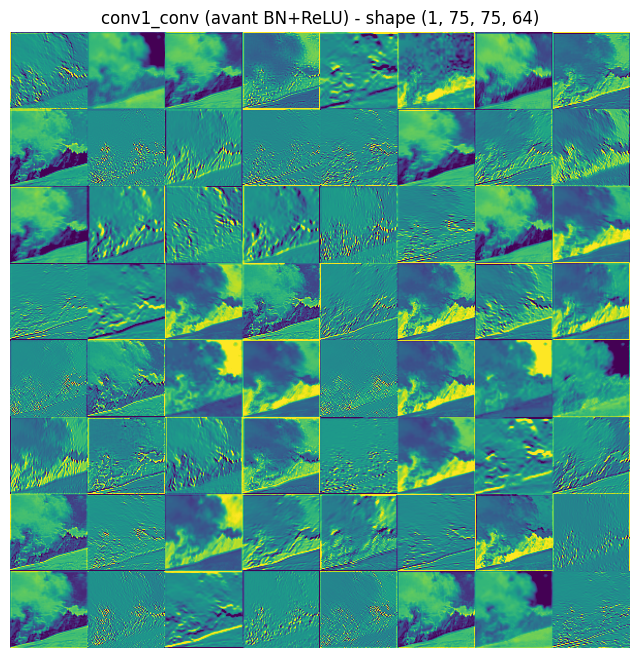

conv1_relu (après BN+ReLU) → shape: (1, 75, 75, 64)


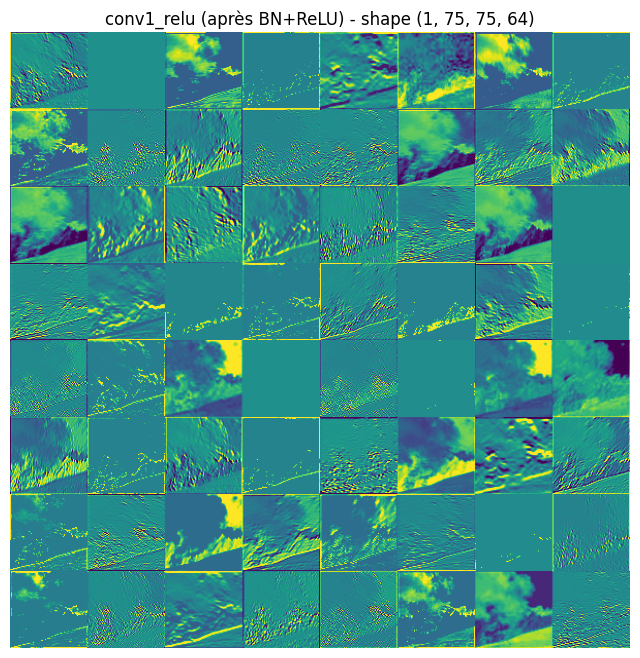

pool1_pool (après MaxPooling) → shape: (1, 38, 38, 64)


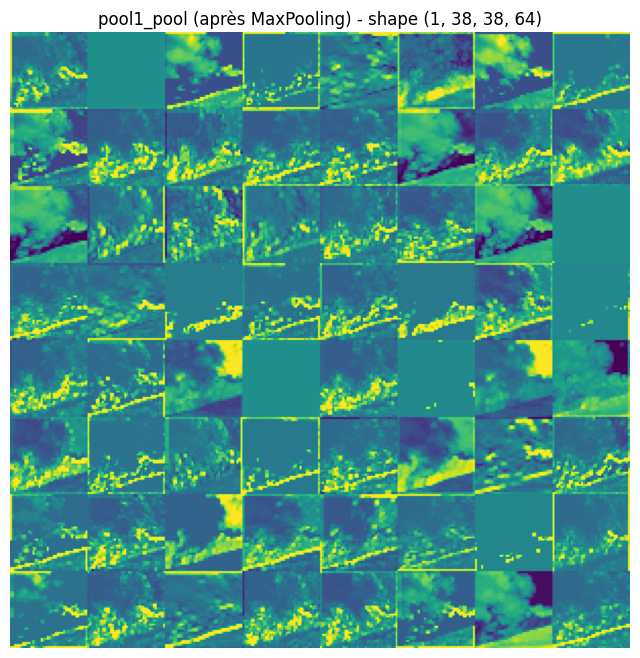

In [47]:
from tensorflow.keras import models
import numpy as np
import matplotlib.pyplot as plt

# Récupérer le backbone ResNet50
base_model = model.get_layer("resnet50")


layer_outputs = [
    base_model.get_layer("conv1_conv").output,
    base_model.get_layer("conv1_relu").output,
    base_model.get_layer("pool1_pool").output
]
activation_model = models.Model(inputs=base_model.input, outputs=layer_outputs)

# Choisir une image
img_tensor = np.expand_dims(X_val[12], axis=0)

# Obtenir les activations
activations = activation_model.predict(img_tensor)

# Noms des couches pour affichage
layer_names = [
    "conv1_conv (avant BN+ReLU)",
    "conv1_relu (après BN+ReLU)",
    "pool1_pool (après MaxPooling)"
]

# ----------------------------------------------------------
# Fonction pour afficher les activations d’une couche
# ----------------------------------------------------------
def display_activation(activation, layer_name):
    n_features = activation.shape[-1]  # nombre de filtres
    size = activation.shape[1]

    # Afficher la shape réelle
    print(f"{layer_name} → shape: {activation.shape}")

    images_per_row = 8
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = activation[0, :, :, col * images_per_row + row]
            channel_image -= channel_image.mean()
            channel_image /= (channel_image.std() + 1e-5)
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size:(col+1)*size,
                         row * size:(row+1)*size] = channel_image

    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    # 👉 Ajouter la shape au titre
    plt.title(f"{layer_name} - shape {activation.shape}")
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    plt.axis("off")
    plt.show()

# ----------------------------------------------------------
# Afficher conv1_conv, conv1_relu et pool1_pool
# ----------------------------------------------------------
for act, name in zip(activations, layer_names):
    display_activation(act, name)



### 7.3. Évaluation du modèle final sur de nouvelles données (SegTest)

Nous avons maintenant retenu notre **meilleur modèle (Transfer Learning)** comme modèle final.  
Nous allons l’évaluer sur un nouveau jeu de données : **SegTest**.  

 L’objectif est de tester les performances du modèle sur des **images totalement nouvelles**, jamais vues pendant l’entraînement ni la validation, afin de mesurer sa véritable capacité de **généralisation**.  


94/94 ━━━━━━━━━━━━━━━━━━━━ 113s 1s/step


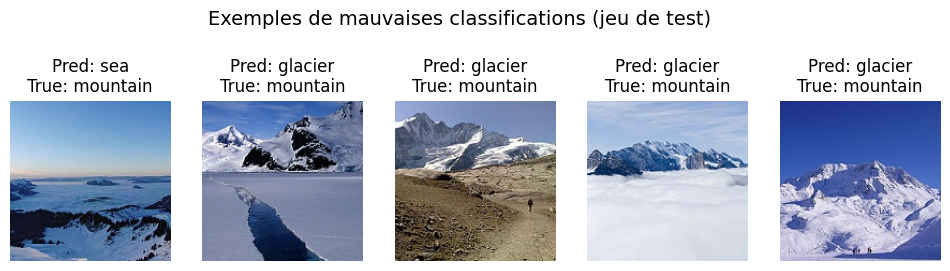

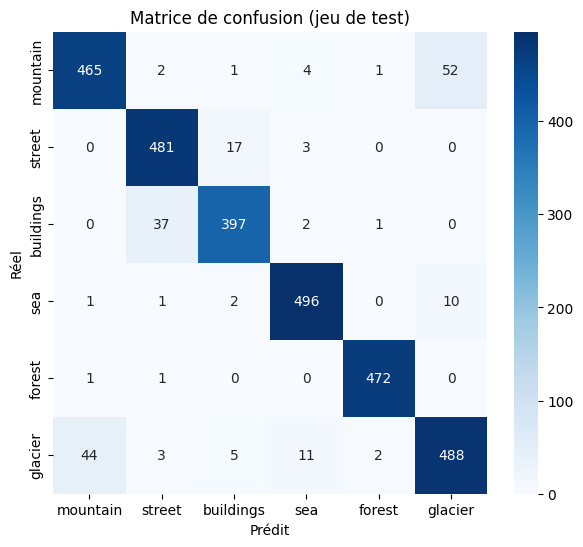

Rapport de classification (jeu de test) :

              precision    recall  f1-score   support

    mountain       0.91      0.89      0.90       525
      street       0.92      0.96      0.94       501
   buildings       0.94      0.91      0.92       437
         sea       0.96      0.97      0.97       510
      forest       0.99      1.00      0.99       474
     glacier       0.89      0.88      0.88       553

    accuracy                           0.93      3000
   macro avg       0.93      0.93      0.93      3000
weighted avg       0.93      0.93      0.93      3000



In [68]:
# 1. Charger et préparer les données du jeu de test
test_dir = "/kaggle/input/intel-image-classification/seg_test/seg_test"
img_size = (150, 150)

X_test = []
y_test = []
classes = os.listdir(test_dir)

for idx, c in enumerate(classes):
    folder = os.path.join(test_dir, c)
    for file in os.listdir(folder):
        img_path = os.path.join(folder, file)
        img = Image.open(img_path).resize(img_size)
        img = np.array(img)
        X_test.append(img)
        y_test.append(idx)

X_test = np.array(X_test) / 255.0   # normalisation
y_test = np.array(y_test)

# 2. Prédictions
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = y_test  # pas besoin de one-hot ici

# 3. Quelques erreurs de classification
misclassified_idx = np.where(y_pred_classes != y_true)[0]

plt.figure(figsize=(12,6))
for i, idx in enumerate(misclassified_idx[:5]):  # afficher 5 erreurs
    plt.subplot(1,5,i+1)
    plt.imshow(X_test[idx])
    plt.title(f"Pred: {classes[y_pred_classes[idx]]}\nTrue: {classes[y_true[idx]]}")
    plt.axis("off")
plt.suptitle("Exemples de mauvaises classifications (jeu de test)", fontsize=14, y=0.78)
plt.show()

# 4. Matrice de confusion
cm = confusion_matrix(y_true, y_pred_classes)

plt.figure(figsize=(7,6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=classes,
            yticklabels=classes)
plt.xlabel("Prédit")
plt.ylabel("Réel")
plt.title("Matrice de confusion (jeu de test)")
plt.show()

# 5. Rapport de classification
print("Rapport de classification (jeu de test) :\n")
print(classification_report(y_true, y_pred_classes, target_names=classes))


### Analyse des erreurs courantes

La matrice de confusion et le rapport de classification montrent que notre modèle atteint une **excellente performance globale**  
(`accuracy = 0.93` sur le jeu de test). Les scores de précision et de rappel sont très élevés, ce qui confirme la robustesse du modèle.  

Cependant, certaines **confusions récurrentes** apparaissent :  

- **Buildings vs Street** :  
  Les images de bâtiments sont parfois classées comme "street".  
   Cela est logique, car dans beaucoup de photos de rues, on voit aussi des bâtiments en arrière-plan, ce qui rend la distinction plus difficile.  

- **Mountain vs Glacier** :  
  La classe "mountain" est souvent confondue avec "glacier".  
   Cette confusion est compréhensible car les paysages montagneux enneigés ressemblent visuellement à des glaciers (neige, reliefs, couleur dominante blanche).  

- **Sea vs Glacier** (plus rare) :  
  Certaines images de mer avec des zones blanches (mousses, vagues, glace flottante) peuvent prêter à confusion avec des glaciers. Le modèle a parfois du mal à distinguer la texture uniforme de la mer de la texture enneigée des glaciers.

---

### Rapport de classification
- Les meilleures performances sont obtenues pour **forest** (precision = 0.99, recall = 1.00, f1 = 0.99) et **sea** (precision = 0.96, recall et f1 = 0.97).  
- Les classes **buildings** (f1 = 0.92) et **street** (f1 = 0.94) sont légèrement plus faibles, en raison des confusions entre elles.  
- Les classes **mountain** (f1 = 0.90) et **glacier** (f1 = 0.88) ont également des scores un peu plus bas, dues à leur similarité visuelle.  

---

 En résumé :  
Le modèle est globalement très performant et atteint une **précision de 93%** sur des données totalement nouvelles.  
Les erreurs observées sont cohérentes et s’expliquent par la proximité visuelle entre certaines classes (par ex. *mountain vs glacier* ou *street vs buildings*).  


## 7.4. Visualisation par Occlusion Sensitivity

### Qu’est-ce que l’Occlusion Sensitivity ?
L’**occlusion sensitivity** est une méthode d’explicabilité qui consiste à masquer (occulter) différentes parties d’une image pour observer l’impact de ce masquage sur la prédiction du modèle.  
- Si la **prédiction chute fortement** lorsqu’une zone est masquée, cela signifie que cette zone est **importante** pour la classification.  
- Inversement, si le modèle conserve sa prédiction malgré l’occlusion, cela veut dire que la zone n’apporte pas d’information cruciale.

Les résultats sont représentés sous forme de **heatmap** :  
- **Rouge/jaune** → zones très importantes pour la prédiction.  
- **Vert** → zones d’importance intermédiaire.  
- **Bleu** → zones peu ou pas importantes. 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━

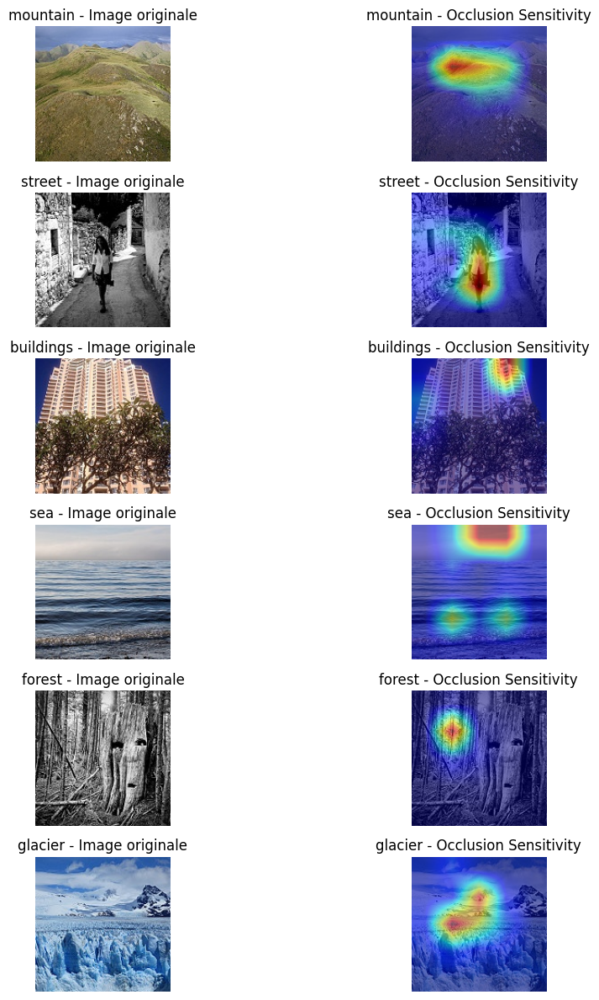

In [43]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tensorflow.keras.preprocessing import image

# Fonction d’occlusion sensitivity
def occlusion_sensitivity(img_array, model, patch_size=30, stride=30):
    h, w, _ = img_array.shape
    heatmap = np.zeros((h // stride, w // stride))

    original_pred = model.predict(img_array[np.newaxis, ...])[0]
    class_idx = np.argmax(original_pred)

    for i in range(0, h - patch_size, stride):
        for j in range(0, w - patch_size, stride):
            occluded = img_array.copy()
            occluded[i:i+patch_size, j:j+patch_size, :] = 0
            pred = model.predict(occluded[np.newaxis, ...])[0]
            heatmap[i // stride, j // stride] = original_pred[class_idx] - pred[class_idx]

    heatmap = cv2.resize(heatmap, (w, h))
    return heatmap, class_idx

# Chemin dataset test
test_dir = "/kaggle/input/intel-image-classification/seg_test/seg_test"

classes = ["mountain", "street", "buildings", "sea", "forest", "glacier"]

img_size = (150, 150)

plt.figure(figsize=(12, 12))

for idx, cls in enumerate(classes):
    # Charger une image de chaque classe
    img_path = os.path.join(test_dir, cls, os.listdir(os.path.join(test_dir, cls))[0])
    img = image.load_img(img_path, target_size=img_size)
    img_array = image.img_to_array(img) / 255.0

    # Calcul occlusion
    heatmap, class_idx = occlusion_sensitivity(img_array, model)

    # Affichage
    plt.subplot(6, 2, 2*idx+1)
    plt.imshow(img_array)
    plt.title(f"{cls} - Image originale")
    plt.axis("off")

    plt.subplot(6, 2, 2*idx+2)
    plt.imshow(img_array)
    plt.imshow(heatmap, cmap='jet', alpha=0.5)
    plt.title(f"{cls} - Occlusion Sensitivity")
    plt.axis("off")

plt.tight_layout()
plt.show()


### Analyse des 6 images

1. **Street**
   - Zone la plus importante : la partie centrale de l’image (les pavés et la silhouette).  
   - Interprétation : le modèle se base sur les éléments caractéristiques de la rue.

2. **Buildings**
   - Zone la plus importante : la partie centrale avec la façade du bâtiment.  
   - Interprétation : le modèle détecte les structures rectangulaires, typiques des bâtiments.

3. **Sea**
   - Zones les plus importantes : la ligne d’horizon et les surfaces planes de l’eau.  
   - Interprétation : la séparation mer/ciel est un indice fort pour reconnaître la mer.

4. **Forest**
   - Zone la plus importante : le tronc central visible dans l’image.  
   - Interprétation : le modèle se concentre sur la texture verticale.

5. **Glacier**
   - Zones les plus importantes : la partie enneigée centrale et les contrastes entre neige et roche.  
   - Interprétation : le modèle identifie le glacier grâce aux zones blanches/bleutées et aux textures de glace.

6. **Mountain**
   - Zone la plus importante : la pente rocheuse centrale du relief.  
   - Interprétation : le modèle s’appuie sur les contours nets et les pentes inclinées pour reconnaître une montagne.

---

### 7.5. Conclusion

L’analyse des erreurs (matrice de confusion et occlusion sensitivity) a montré que certaines classes sont encore difficiles à distinguer :

- **Mountains vs Glacier** : les paysages enneigés de montagne ressemblent visuellement aux glaciers.
- **Street vs Buildings** : les rues contenant des bâtiments en arrière-plan perturbent le modèle.
- **Sea vs Glacier** : certaines mers avec reflets blancs ou glace flottante peuvent être confondues avec un glacier.

#### Solutions proposées

1. **Augmentation de données ciblée**
   - Ajouter des transformations spécifiques (contraste, luminosité, zoom) pour renforcer la robustesse du modèle face aux paysages semblables.
   - Générer plus d’images de glaciers et de montagnes avec variations (neige, roches, ciel dégagé).

2. **Utiliser des modèles pré-entraînés plus puissants**
   - Tester des architectures plus complexes (EfficientNet, ResNet101, DenseNet), capables de capturer davantage de nuances visuelles.

3. **Techniques avancées**
   - Explorer l’attention visuelle (Vision Transformers) pour que le modèle se concentre sur des zones clés de l’image.
   - Ajouter des **filtres spécialisés** (edge detection, texture analysis) en prétraitement pour renforcer les différences entre glaciers et montagnes.

---

En résumé : le modèle actuel est déjà performant (93% de précision), mais en combinant **plus de données variées** et éventuellement un **modèle plus puissant**, on peut encore réduire les confusions entre classes proches.
